In [1]:
!pip install ultralytics

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 40.2/40.2 kB 1.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 709.3/709.3 kB 13.8 MB/s eta 0:00:00


In [2]:
import ultralytics

from ultralytics import YOLO
import os
from PIL import Image
import cv2
from IPython.display import Video
import glob
import matplotlib.pyplot as plt

import warnings
warnings.filterwarnings('ignore')


ultralytics.checks()

Ultralytics YOLOv8.1.9 🚀 Python-3.10.13 torch-2.1.2 CUDA:0 (Tesla T4, 15102MiB)
Setup complete ✅ (4 CPUs, 31.4 GB RAM, 5432.0/8062.4 GB disk)


In [3]:
model = YOLO('yolov8s.pt')

100%|██████████| 21.5M/21.5M [00:00<00:00, 163MB/s]


In [4]:
Root_dir = '/kaggle/input/chess-pieces-detection-image-dataset/Chess_pieces'

In [5]:
yaml_path = os.path.join(Root_dir, 'data.yaml.yaml')

In [6]:
train_path = os.path.join(Root_dir, 'train', 'images')
valid_path = os.path.join(Root_dir, 'valid', 'images')

In [7]:
results = model.train(
    data=yaml_path,
    epochs=15,
    batch=32,
    lr0=0.0001, 
    lrf=0.1,
    imgsz=640,
    plots= True
)

Ultralytics YOLOv8.1.9 🚀 Python-3.10.13 torch-2.1.2 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8s.pt, data=/kaggle/input/chess-pieces-detection-image-dataset/Chess_pieces/data.yaml.yaml, epochs=15, time=None, patience=50, batch=32, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=Fa

100%|██████████| 755k/755k [00:00<00:00, 14.2MB/s]
2024-02-02 09:10:28,834	INFO util.py:124 -- Outdated packages:
  ipywidgets==7.7.1 found, needs ipywidgets>=8
Run `pip install -U ipywidgets`, then restart the notebook server for rich notebook output.
2024-02-02 09:10:29,719	INFO util.py:124 -- Outdated packages:
  ipywidgets==7.7.1 found, needs ipywidgets>=8
Run `pip install -U ipywidgets`, then restart the notebook server for rich notebook output.
2024-02-02 09:10:31.980733: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-02-02 09:10:31.980832: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-02-02 09:10:32.105756: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS facto

Overriding model.yaml nc=80 with nc=13

                   from  n    params  module                                       arguments                     
  0                  -1  1       928  ultralytics.nn.modules.conv.Conv             [3, 32, 3, 2]                 
  1                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  2                  -1  1     29056  ultralytics.nn.modules.block.C2f             [64, 64, 1, True]             
  3                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  4                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  5                  -1  1    295424  ultralytics.nn.modules.conv.Conv             [128, 256, 3, 2]              
  6                  -1  2    788480  ultralytics.nn.modules.block.C2f             [256, 256, 2, True]           
  7                  -1  1   1180672  ultralytic

100%|██████████| 6.23M/6.23M [00:00<00:00, 75.4MB/s]


AMP: checks passed ✅


train: Scanning /kaggle/input/chess-pieces-detection-image-dataset/Chess_pieces/train/labels... 606 images, 0 backgrounds, 0 corrupt: 100%|██████████| 606/606 [00:02<00:00, 293.87it/s]

train: WARNING ⚠️ /kaggle/input/chess-pieces-detection-image-dataset/Chess_pieces/train/images/26d663ab5ffbec49f9dc8e592982cfd4_jpg.rf.0fe973299ff9e73874d9e684cba4e406.jpg: 1 duplicate labels removed
train: WARNING ⚠️ /kaggle/input/chess-pieces-detection-image-dataset/Chess_pieces/train/images/26d663ab5ffbec49f9dc8e592982cfd4_jpg.rf.5e1a9d49ad09f5a7549225a05e1f66a6.jpg: 1 duplicate labels removed
train: WARNING ⚠️ /kaggle/input/chess-pieces-detection-image-dataset/Chess_pieces/train/images/26d663ab5ffbec49f9dc8e592982cfd4_jpg.rf.bb226be189ee3a6399fbbd5080852e5b.jpg: 1 duplicate labels removed
train: WARNING ⚠️ Cache directory /kaggle/input/chess-pieces-detection-image-dataset/Chess_pieces/train is not writeable, cache not saved.


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


val: Scanning /kaggle/input/chess-pieces-detection-image-dataset/Chess_pieces/valid/labels... 58 images, 0 backgrounds, 0 corrupt: 100%|██████████| 58/58 [00:00<00:00, 231.13it/s]

val: WARNING ⚠️ Cache directory /kaggle/input/chess-pieces-detection-image-dataset/Chess_pieces/valid is not writeable, cache not saved.


Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.0001' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000588, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train
Starting training for 15 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/15      8.11G      1.809      3.802      1.402        468        640: 100%|██████████| 19/19 [00:29<00:00,  1.53s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:04<00:00,  4.68s/it]

                   all         58        386      0.537      0.591      0.542      0.379



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/15      7.89G      1.266      1.341      1.101        338        640: 100%|██████████| 19/19 [00:24<00:00,  1.29s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:02<00:00,  2.29s/it]

                   all         58        386      0.857      0.905      0.928      0.672



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/15      7.75G      1.188     0.9351      1.071        336        640: 100%|██████████| 19/19 [00:24<00:00,  1.28s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.17s/it]

                   all         58        386      0.912      0.944      0.962      0.708



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/15      8.08G      1.145     0.8024      1.054        377        640: 100%|██████████| 19/19 [00:25<00:00,  1.34s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.04it/s]

                   all         58        386       0.93      0.913      0.966      0.705



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/15      8.03G      1.101     0.7089      1.037        338        640: 100%|██████████| 19/19 [00:24<00:00,  1.31s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.01s/it]

                   all         58        386      0.953      0.978      0.978      0.719


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/15      7.97G      1.051     0.6455      1.058        266        640: 100%|██████████| 19/19 [00:15<00:00,  1.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.18it/s]

                   all         58        386      0.948      0.935      0.981      0.721



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/15      7.96G      1.058     0.6097      1.052        322        640: 100%|██████████| 19/19 [00:10<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.45it/s]

                   all         58        386      0.935      0.977      0.986      0.716



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/15      7.98G      1.011     0.5511      1.026        355        640: 100%|██████████| 19/19 [00:10<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.80it/s]

                   all         58        386      0.935      0.988      0.986      0.734



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/15      8.15G     0.9893     0.5294      1.026        273        640: 100%|██████████| 19/19 [00:11<00:00,  1.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.35it/s]

                   all         58        386      0.968      0.986      0.985       0.73



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/15      7.98G     0.9842     0.5237      1.023        283        640: 100%|██████████| 19/19 [00:10<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.50it/s]

                   all         58        386      0.967      0.978      0.987      0.773



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/15      8.15G     0.9577     0.4933      1.011        361        640: 100%|██████████| 19/19 [00:10<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.20it/s]

                   all         58        386      0.979      0.979      0.984      0.776



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/15      7.97G     0.9684     0.4851      1.019        346        640: 100%|██████████| 19/19 [00:10<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.41it/s]

                   all         58        386      0.986      0.987      0.987      0.782



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/15      8.13G     0.9079     0.4512      0.989        255        640: 100%|██████████| 19/19 [00:11<00:00,  1.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.33it/s]

                   all         58        386      0.985      0.992      0.985       0.78



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/15      7.98G     0.8845     0.4449      0.975        136        640: 100%|██████████| 19/19 [00:10<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.23it/s]

                   all         58        386      0.985      0.988      0.985       0.78



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/15      7.96G     0.8532     0.4256     0.9666        271        640: 100%|██████████| 19/19 [00:10<00:00,  1.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.17it/s]

                   all         58        386      0.981      0.986      0.986       0.79



15 epochs completed in 0.084 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 22.5MB
Optimizer stripped from runs/detect/train/weights/best.pt, 22.5MB

Validating runs/detect/train/weights/best.pt...
Ultralytics YOLOv8.1.9 🚀 Python-3.10.13 torch-2.1.2 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 11130615 parameters, 0 gradients, 28.5 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.42it/s]


                   all         58        386      0.981      0.986      0.986       0.79
          black-bishop         58         22      0.995      0.955      0.959      0.683
            black-king         58         29          1      0.971      0.995      0.834
          black-knight         58         30      0.994          1      0.995      0.799
            black-pawn         58         77      0.998          1      0.995      0.798
           black-queen         58         11      0.909          1      0.995       0.81
            black-rook         58         28      0.998          1      0.995      0.778
          white-bishop         58         22       0.94          1      0.956      0.744
            white-king         58         29      0.996          1      0.995       0.82
          white-knight         58         19      0.947          1      0.985      0.813
            white-pawn         58         77      0.999          1      0.995      0.782
           white-quee

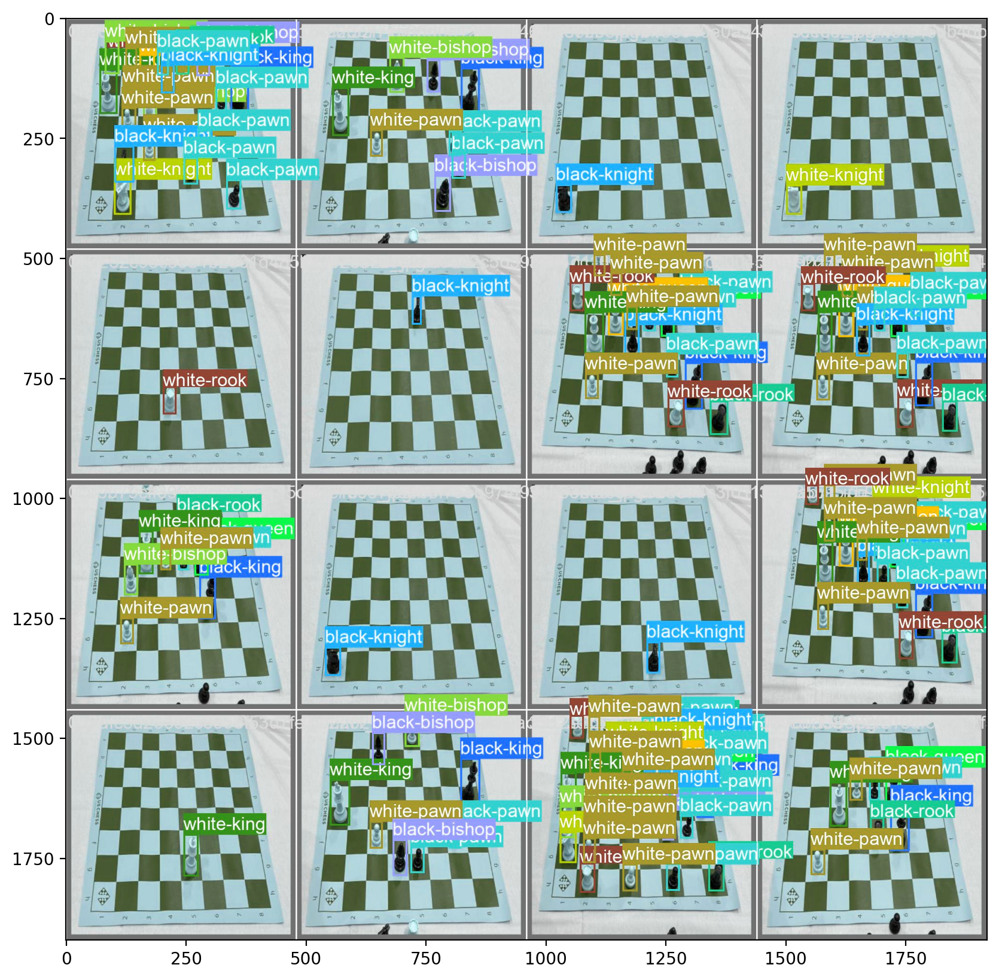

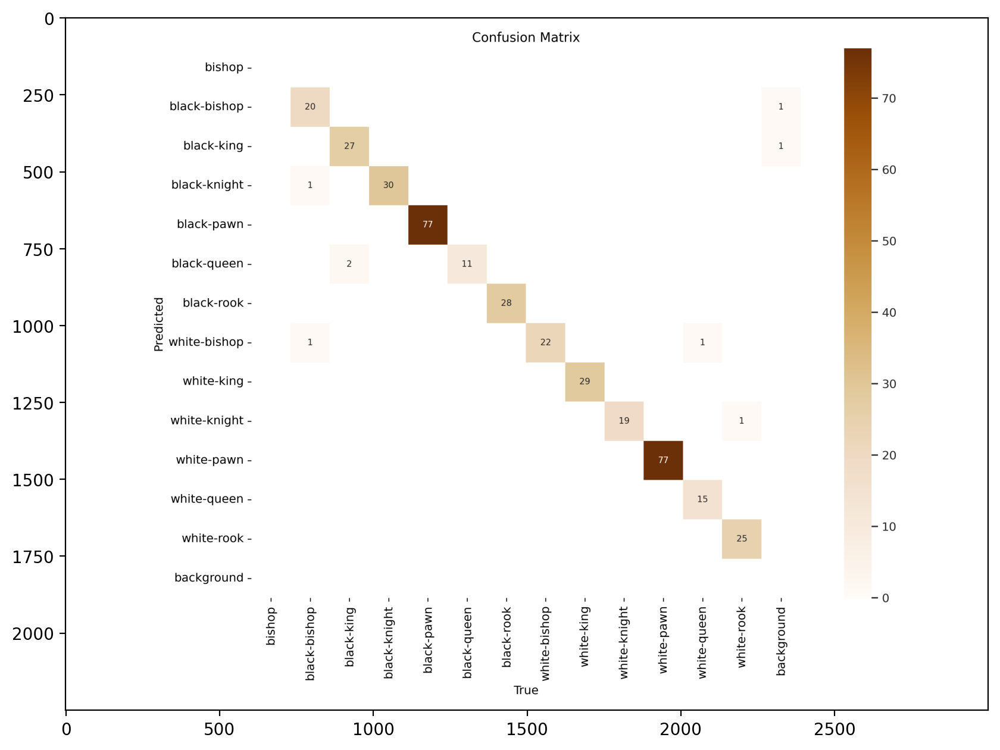

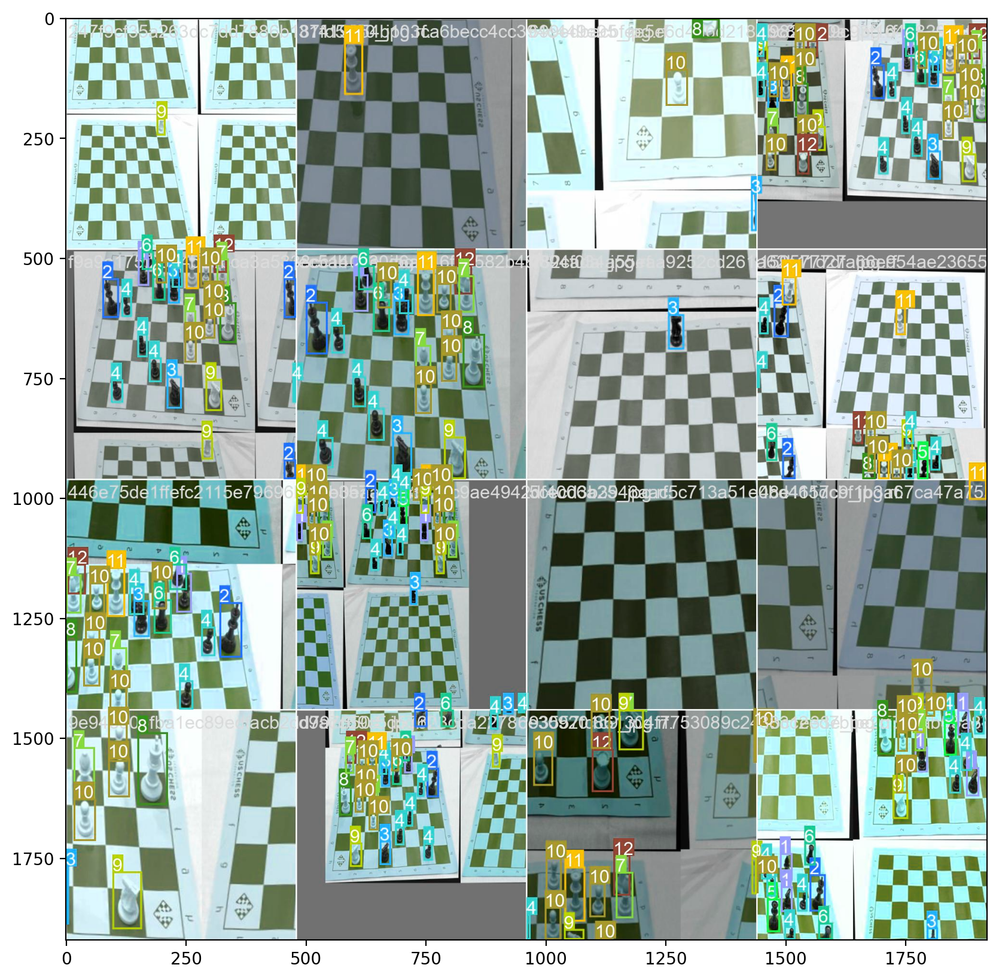

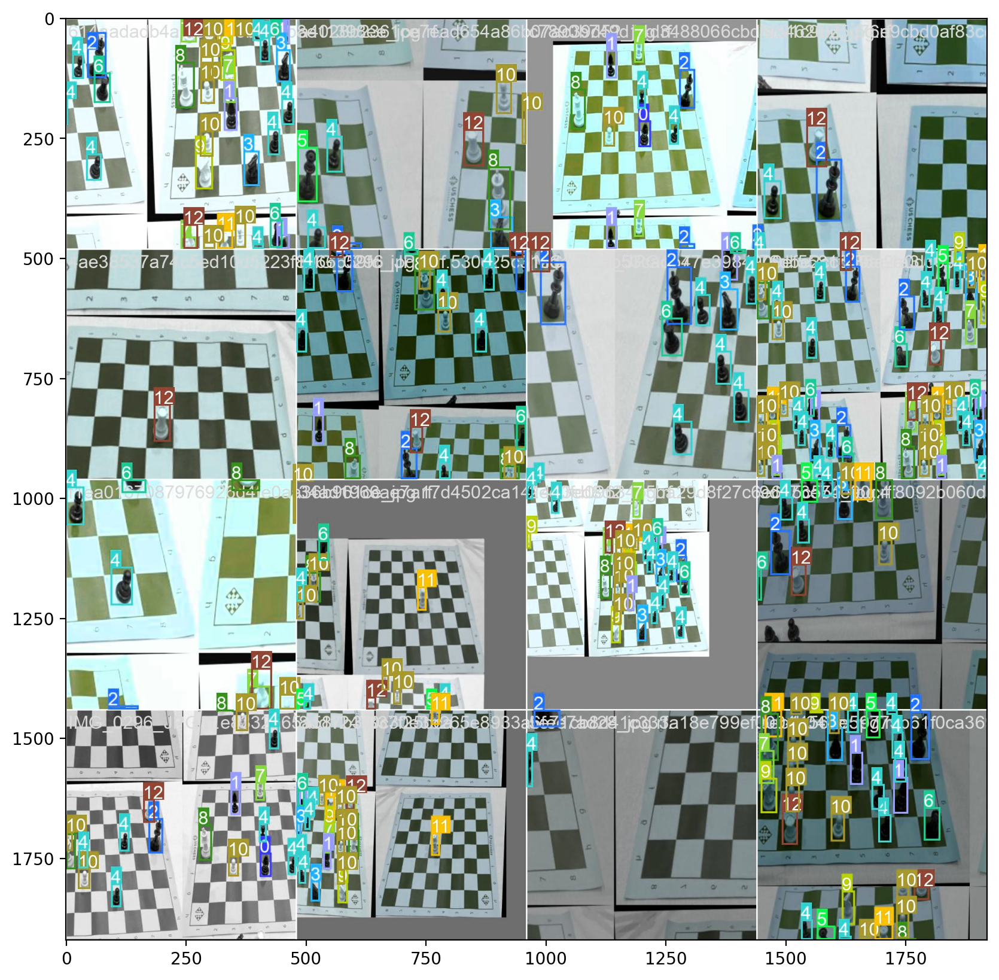

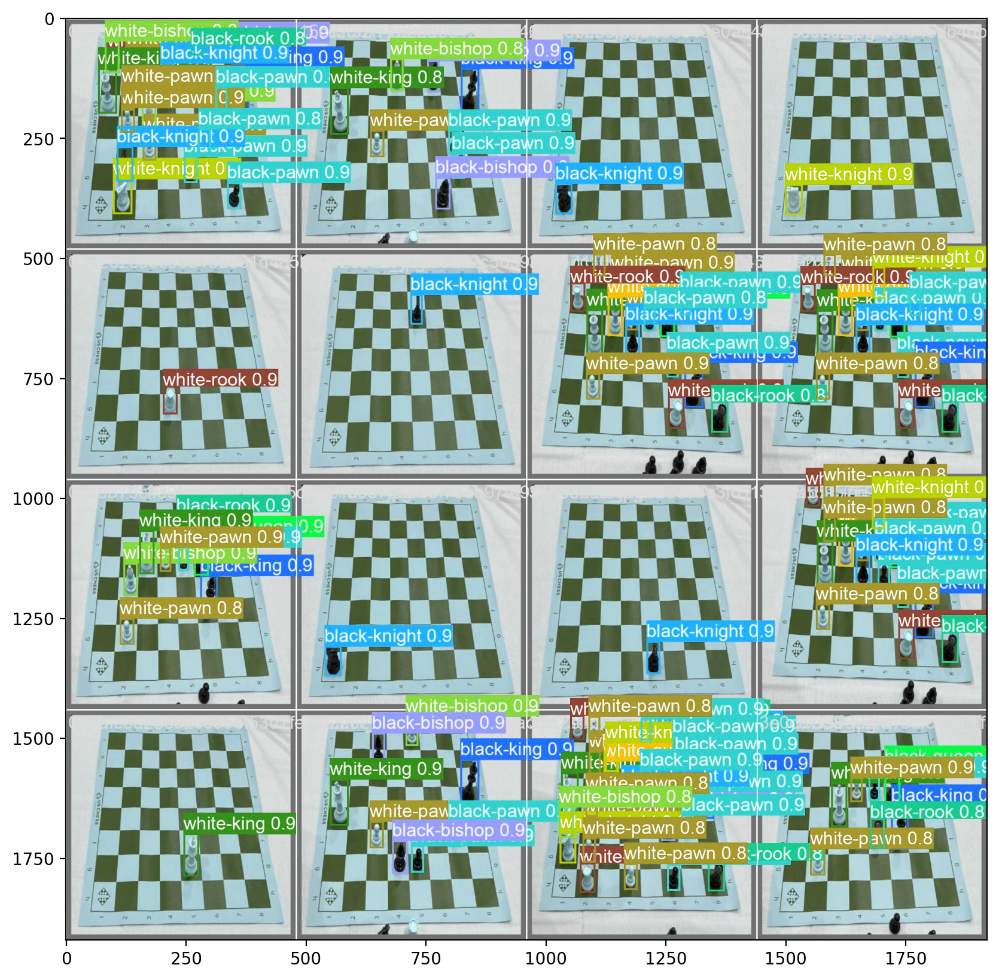

...

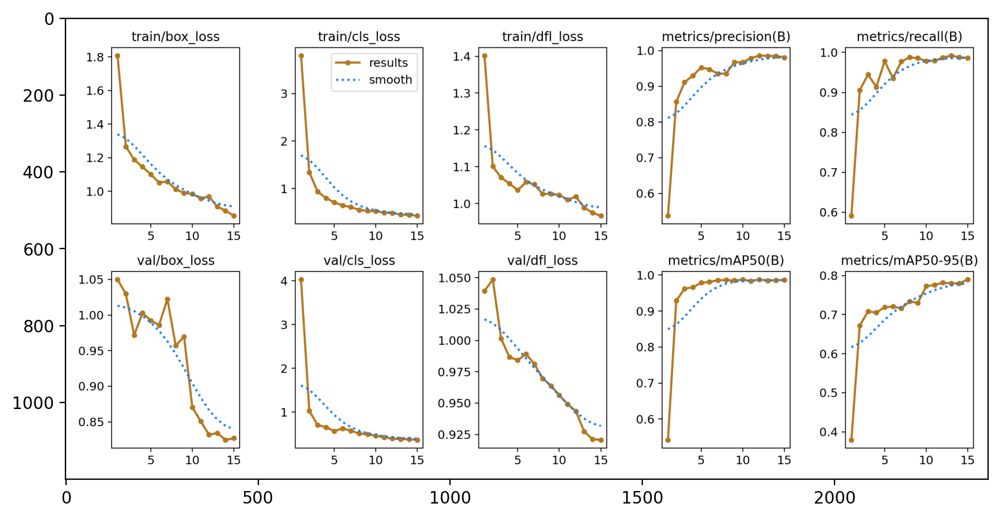

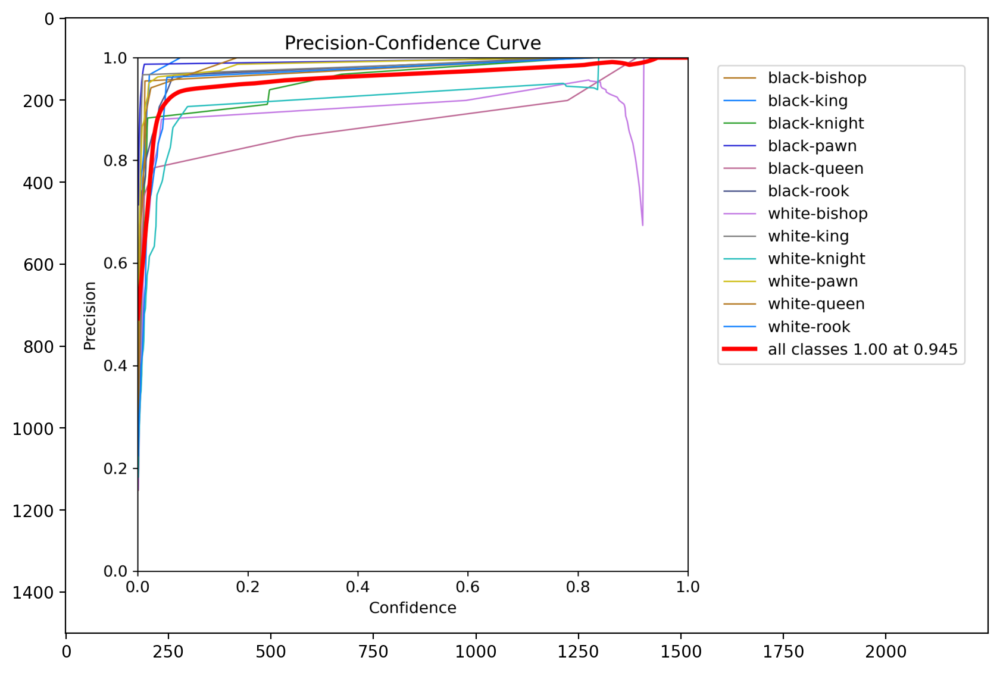

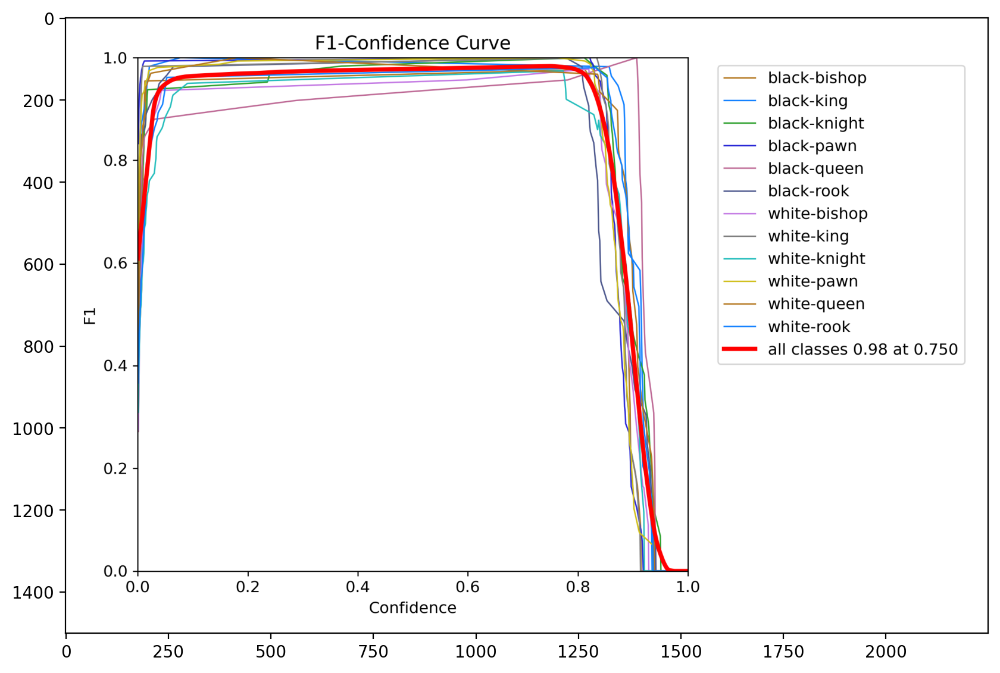

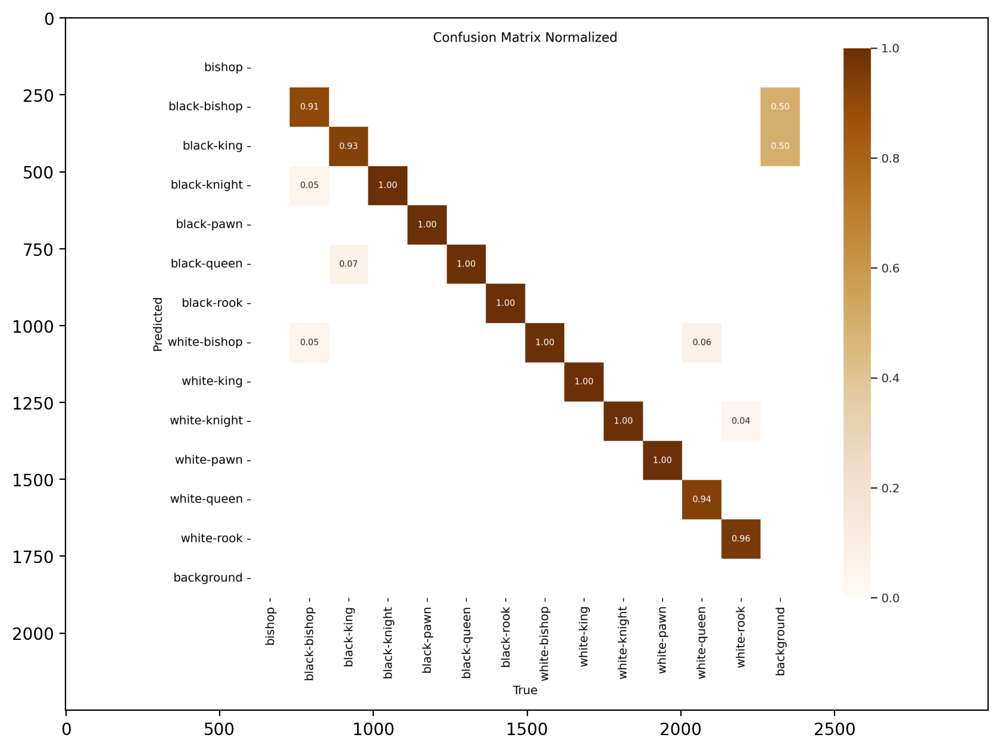

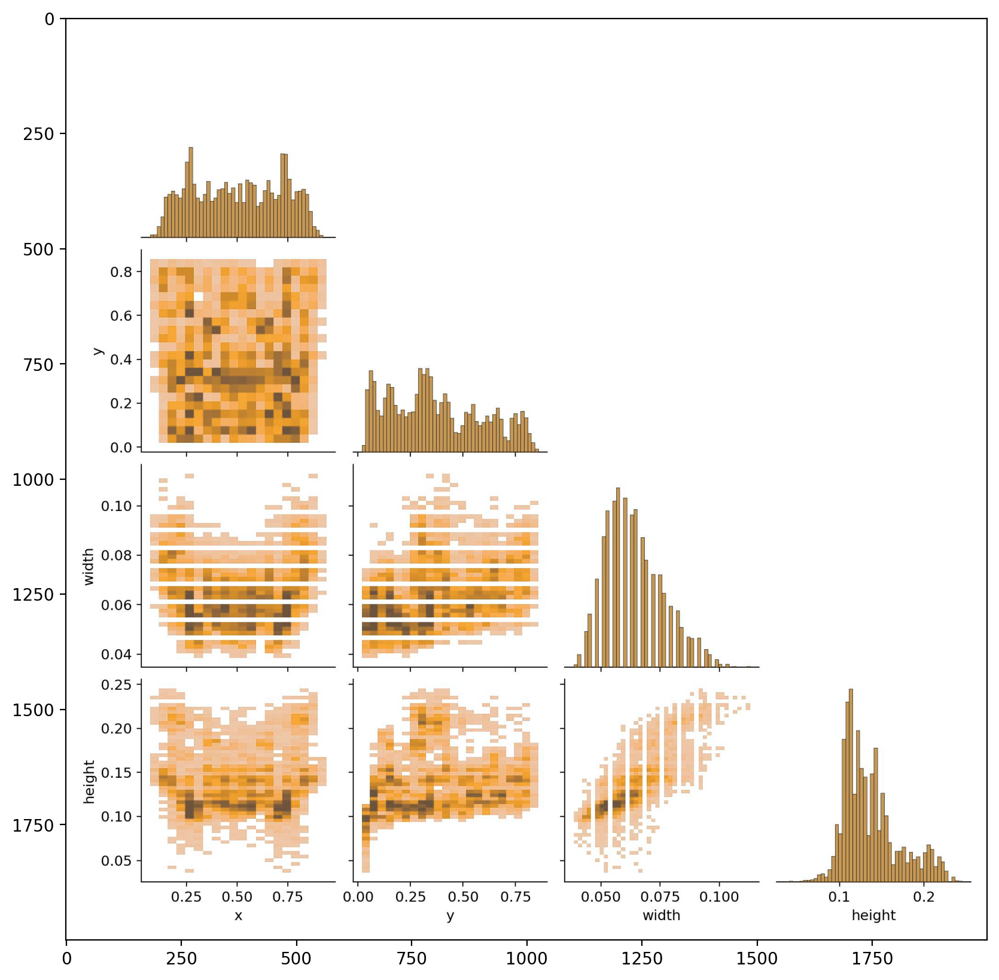

In [8]:
data_dir = "/kaggle/working/runs/detect/train"
img_dir = os.path.join(data_dir, '*g')
files = glob.glob(img_dir)
imgs = []
for image in files:
    img = cv2.imread(image)
    imgs.append(img)
    plt.figure(figsize=(10,10), dpi= 200)
    plt.imshow(img)


image 1/1 /kaggle/input/chess-pieces-detection-image-dataset/Chess_pieces/test/7a34d8620235048917b28bcfd3b5572b_jpg.rf.450c577e3be66b5232c54ffc9ec9e6b7.jpg: 640x640 1 black-rook, 16.4ms
Speed: 2.4ms preprocess, 16.4ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


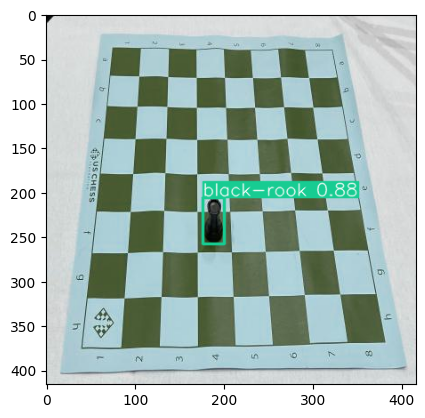

In [9]:
image_test_path = '/kaggle/input/chess-pieces-detection-image-dataset/Chess_pieces/test/7a34d8620235048917b28bcfd3b5572b_jpg.rf.450c577e3be66b5232c54ffc9ec9e6b7.jpg'

results = model.predict(source=image_test_path, 
                        imgsz=640)

test_image = results[0].plot(line_width=2)
plt.imshow(test_image)

In [10]:
example_video_path = '/kaggle/input/chess-pieces-detection-image-dataset/Chess_pieces/Chess_video_example.mp4'

video_output = model.predict(source=example_video_path, conf=0.6,save=True)



WARNING ⚠️ inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (1/1362) /kaggle/input/chess-pieces-detection-image-dataset/Chess_pieces/Chess_video_example.mp4: 384x640 1 black-bishop, 1 black-king, 2 black-knights, 1 white-bishop, 1 white-rook, 94.8ms
video 1/1 (2/1362) /kaggle/input/chess-pieces-detection-image-dataset/Chess_pieces/Chess_video_example.mp4: 384x640 1 black-bishop, 1 black-king, 1 black-knight, 1 white-bishop, 1 white-rook, 10.7ms
video 1/1 (3/1362) /kaggle/input/chess-pieces-detection-i

In [11]:
!ffmpeg -y -loglevel panic -i /kaggle/working/runs/detect/train2/Chess_video_example.avi Chess_video_example.mp4

Video("Chess_video_example.mp4", embed=True, width=960)